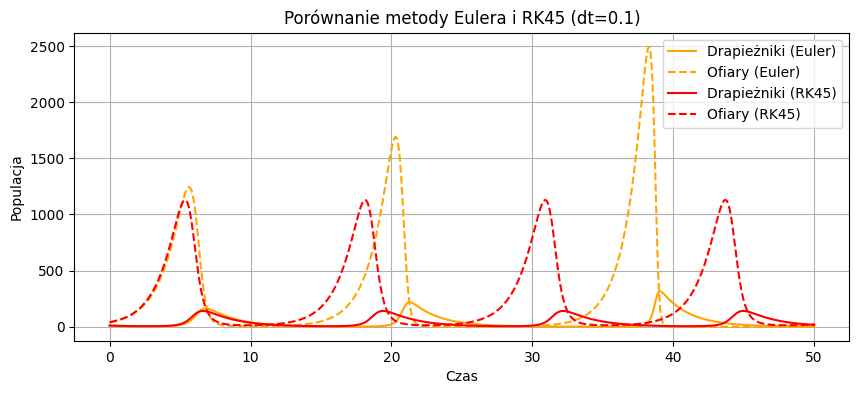

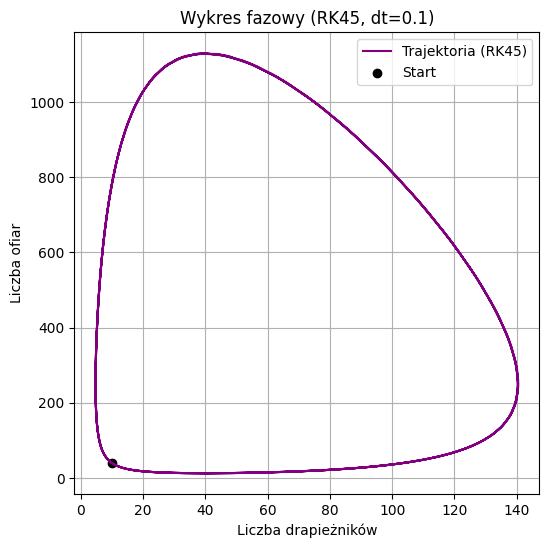

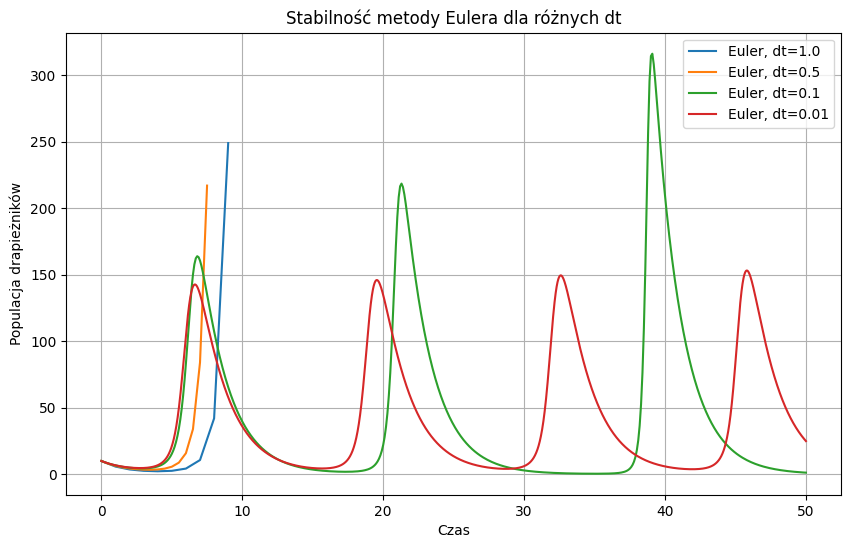

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from scipy.integrate import solve_ivp

# ------------------------------------------------------
# 1. PARAMETRY UKŁADU
# ------------------------------------------------------

a = 0.5
b = 0.8
c = 0.1
d = 0.02

# ------------------------------------------------------
# 2. PRAWA RÓŻNICZKOWE LOTKA–VOLTERRA
# ------------------------------------------------------

def lotka_volterra(t, z):
    x, y = z
    dx_dt = -a * x + c * d * x * y
    dy_dt =  b * y - d * x * y
    return [dx_dt, dy_dt]

# ------------------------------------------------------
# 3. KROK METODY EULERA
# ------------------------------------------------------

def euler_step(x, y, dt):
    dx, dy = lotka_volterra(0, [x, y])
    return x + dx * dt, y + dy * dt

# ------------------------------------------------------
# 4. PEŁNA SYMULACJA (EULER lub RK45)
# ------------------------------------------------------

def simulate(method, x0, y0, dt, t_end, stability_limit=1e6):
    if method == 'euler':
        steps = int(np.ceil(t_end / dt))
        t = np.linspace(0, t_end, steps + 1)
        x = np.zeros(steps + 1)
        y = np.zeros(steps + 1)
        x[0], y[0] = x0, y0

        for i in range(steps):
            x_next, y_next = euler_step(x[i], y[i], dt)
            
            # zabezpieczenie przed wybuchem numerycznym
            if (x_next < 0 or y_next < 0 or x_next > stability_limit or y_next > stability_limit):
                x[i+1:] = np.nan
                y[i+1:] = np.nan
                break

            x[i+1], y[i+1] = x_next, y_next

        return t, x, y

    elif method == 'rk45':
        sol = solve_ivp(
            fun=lotka_volterra,
            t_span=(0, t_end),
            y0=[x0, y0],
            method='RK45',
            t_eval=np.arange(0, t_end+dt, dt),
            rtol=1e-6,
            atol=1e-9
        )
        return sol.t, sol.y[0], sol.y[1]

    else:
        raise ValueError("Metoda musi być 'euler' lub 'rk45'")

# ------------------------------------------------------
# 5. SYMULACJE
# ------------------------------------------------------

x0 = 10
y0 = 40
t_end = 50
dt = 0.1

# Porównanie: Euler i RK45
t_euler, x_euler, y_euler = simulate('euler', x0, y0, dt, t_end)
t_rk45,  x_rk45,  y_rk45  = simulate('rk45', x0, y0, dt, t_end)

# ------------------------------------------------------
# 6. RYSOWANIE: Porównanie Euler vs RK45
# ------------------------------------------------------

plt.figure(figsize=(10, 4))
plt.plot(t_euler, x_euler, label='Drapieżniki (Euler)', color='orange')
plt.plot(t_euler, y_euler, '--', label='Ofiary (Euler)', color='orange')
plt.plot(t_rk45, x_rk45, label='Drapieżniki (RK45)', color='red')
plt.plot(t_rk45, y_rk45, '--', label='Ofiary (RK45)', color='red')
plt.xlabel('Czas')
plt.ylabel('Populacja')
plt.title('Porównanie metody Eulera i RK45 (dt=0.1)')
plt.legend()
plt.grid(True)
plt.show()

# ------------------------------------------------------
# 7. WYKRES FAZOWY
# ------------------------------------------------------

plt.figure(figsize=(6, 6))
plt.plot(x_rk45, y_rk45, color='purple', label='Trajektoria (RK45)')
plt.scatter(x_rk45[0], y_rk45[0], color='black', label='Start')
plt.xlabel('Liczba drapieżników')
plt.ylabel('Liczba ofiar')
plt.title('Wykres fazowy (RK45, dt=0.1)')
plt.legend()
plt.grid(True)
plt.show()

# ------------------------------------------------------
# 8. STABILNOŚĆ EULERA DLA RÓŻNYCH dt
# ------------------------------------------------------

dts = [1.0, 0.5, 0.1, 0.01]
plt.figure(figsize=(10, 6))

for dt_test in dts:
    t_tmp, x_tmp, _ = simulate('euler', x0, y0, dt_test, t_end)
    plt.plot(t_tmp, x_tmp, label=f'Euler, dt={dt_test}')

plt.xlabel('Czas')
plt.ylabel('Populacja drapieżników')
plt.title('Stabilność metody Eulera dla różnych dt')
plt.legend()
plt.grid(True)
plt.show()

# ------------------------------------------------------
# 9. ANIMACJA FAZOWA (RK45)
# ------------------------------------------------------

fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim(0, np.max(x_rk45)*1.1)
ax.set_ylim(0, np.max(y_rk45)*1.1)
ax.set_xlabel('Liczba drapieżników')
ax.set_ylabel('Liczba ofiar')
ax.set_title('Animacja fazowa (RK45, dt=0.1)')

line, = ax.plot([], [], lw=2, color='orange')
point, = ax.plot([], [], 'ro')

def init():
    line.set_data([], [])
    point.set_data([], [])
    return line, point

def animate(i):
    line.set_data(x_rk45[:i], y_rk45[:i])
    point.set_data([x_rk45[i]], [y_rk45[i]])
    return line, point

anim = FuncAnimation(
    fig, animate, init_func=init,
    frames=len(t_rk45), interval=50, blit=True
)

plt.close(fig)
HTML(anim.to_jshtml())

# Wnioski z symulacji modelu drapieżnik–ofiara (Lotka–Volterra)

## 1. Charakterystyka modelu

Model opisuje wzajemne oddziaływanie drapieżników $x(t)$ i ofiar $y(t)$ przez układ:

$$
\begin{aligned}
\frac{dx}{dt} &= -a\,x + c\,d\,x\,y, \\
\frac{dy}{dt} &= b\,y - d\,x\,y
\end{aligned}
$$

gdzie:

* $a = 0.5$ – śmiertelność drapieżników przy braku ofiar,  
* $b = 0.8$ – tempo wzrostu ofiar przy braku drapieżników,  
* $c = 0.1$ – efektywność konwersji energii zdobytej z ofiar przez drapieżniki,  
* $d = 0.02$ – skuteczność polowania.

Punkt równowagi spełnia:

$$
x^{\ast}=\frac{b}{d}, \qquad 
y^{\ast}=\frac{a}{c\,d}
$$

czyli dla przyjętych parametrów:

$$
x^{\ast}\approx 40, \qquad 
y^{\ast}\approx 250.
$$

---

## 2. Porównanie metod numerycznych

| Cecha | Euler $(\Delta t = 0.1)$ | RK45 $(\Delta t \approx 0.1)$ |
|-------|---------------------------|------------------------------|
| **Dokładność** | Widoczne przesunięcia fazy i amplitudy po kilku cyklach | Bardzo wierna trajektoria |
| **Stabilność** | Silnie zależna od $\Delta t$; większe kroki prowadzą do tłumienia lub eksplozji | Stabilna dla szerokiego zakresu kroków dzięki adaptacji |
| **Koszt obliczeń** | Mały koszt na krok; wymaga bardzo małego $\Delta t$ dla dobrej jakości | Wyższy koszt na krok, ale znacznie mniej kroków przez adaptacyjny dobór $\Delta t$ |

**Wniosek:** RK45 pozwala na automatyczny dobór długości kroku, zachowując wysoką dokładność bez potrzeby ręcznej regulacji $\Delta t$.

---

## 3. Stabilność metody Eulera

Test dla $\Delta t \in \{1.0,\;0.5,\;0.1,\;0.01\}$:

* **$\Delta t = 1.0$** — szybka eksplozja numeryczna; populacje osiągają ekstremalne wartości lub NaN.  
* **$\Delta t = 0.5$** — sztuczne tłumienie i spłaszczenie trajektorii.  
* **$\Delta t = 0.1$** — wyniki akceptowalne, ale pojawiają się dryfy fazy i amplitudy.  
* **$\Delta t = 0.01$** — dobra zgodność z RK45, ale kosztem znacznego zwiększenia liczby kroków (10x więcej).

**Wniosek:** metoda Eulera wymaga bardzo małych kroków, aby utrzymać stabilność i sensowną dokładność — przez co staje się czasochłonna i mało efektywna.

---

## 4. Analiza fazowa

* Trajektoria $(x,y)$ tworzy zamknięte, elipsoidalne orbity wokół punktu równowagi – klasyczna cecha modelu Lotki–Volterry.  
* Brak tłumienia → oscylacje są **konserwatywne** (energia układu pozostaje stała).  
* Punkt startowy $(x_0 = 10,\; y_0 = 40)$ leży wewnątrz orbity równowagi: amplitudy są mniejsze, okres pozostaje stały.

---

## 5. Animacja trajektorii

Klatka po klatce widać, że:

1. Wzrost liczby ofiar prowadzi do wzrostu drapieżników.  
2. Przy dużej liczbie drapieżników liczba ofiar spada, ograniczając rozwój drapieżników.  
3. Spadek drapieżników umożliwia ponowny wzrost ofiar.  
4. Cykl oscylacyjny powtarza się stabilnie.

Animacja stanowi wizualną ilustrację sprzężenia zwrotnego w systemie.

---

## 6. Kluczowe obserwacje praktyczne

1. **RK45 zdecydowanie przewyższa Eulera** pod względem dokładności i stabilności przy praktycznie porównywalnym czasie całkowitym symulacji.  
2. **Wybór $\Delta t$** jest kluczowy dla Eulera — nawet niewielkie przekroczenie granicy stabilności prowadzi do wykładniczych błędów.  
3. **Model Lotki–Volterry** nie uwzględnia tłumienia środowiskowego ani losowości — w naturze takie oscylacje zwykle są tłumione.  
4. **Wykres fazowy** natychmiast pokazuje jakość integracji — wszelkie deformacje pętli fazowej sugerują problemy numeryczne.

Podsumowując, metoda RK45 (adaptacyjna Runge-Kutta 5(4)) pozwala wiernie odwzorować dynamikę modelu nawet dla wymagających układów nieliniowych, podczas gdy prosty Euler jest bardzo wrażliwy na dobór kroku i w praktyce rzadko bywa efektywny w takich zadaniach.